Word classification

developed by Kow Kuroda (kow.kuroda@gmail.com)
created on 2024/12/13

Requirements
Python 3.11 or later is required for Neural Network classification to be successful. Note that Python 3.10 hangs at NN_model.fit (...).

# Preparation

In [61]:
## language selection
target_langs          = [ 'Czech', 'French', 'German', 'Irish', 'Finnish' ]
target_lang           = target_langs[1]
## OE data is too small
#target_langs_x         = [ 'French', 'OE', 'Gaelic', 'Italian', 'Spanish', 'Welsh' ]
print(f"target_lang: {target_lang}")

##
source_types          = [ 'spell', 'sound' ]
source_type           = source_types[0]
print(f"source_type: {source_type}")

target_lang: French
source_type: spell


In [62]:
## settings
check                 = False

## operational
max_doc_length        = 9 # longer doc takes longer time to process
min_doc_length        = 3
#sample_size           = 1200
sample_size           = 2000
sample_n              = sample_size # alias
print(f"sample_n: {sample_n}")
reuse_sample          = False # retain the samples rather than renewing samples
balance_data          = False

sample_n: 2000


In [63]:
## doc settings
## orthography handling
uncapitalize          = True
print(f"uncapitalize: {uncapitalize}")

remove_diacritics     = True
print(f"remove_diacritics: {remove_diacritics}")

## boundary marking
mark_start            = False
mark_end              = False

if mark_end or mark_start:
    mark_boundaries   = True
else:
    mark_boundaries   = False
print(f"mark_boundaries: {mark_boundaries}")

## define hash as dependent dummy variable
if mark_boundaries:
    if mark_end and mark_start:
        hash_status  = "-hash-at-both"

    elif mark_end and not mark_start:
        hash_status  = "-hash-at-end"

    else:
        hash_status  = "-hashed-at-start"
else:
    hash_status      = "-no-hash"
print(f"hash_status: {hash_status}")

uncapitalize: True
remove_diacritics: True
mark_boundaries: False
hash_status: -no-hash


In [64]:
## term settings
## skippy{4,5}grams demand a longer time to complete
use_regex_to_split    = False
word_splitter         = r""

## n-grams
ngram_is_inclusive   = True
#inclusion_degree     = 1 # Valid values {1, 2, ... None}. None means truly recursive
print(f"ngram_is_inclusive: {ngram_is_inclusive}")

## term type: skippy-{4,5}-grams takes much time to generate
ngram_is_skippy      = True
n_for_ngram          = 2
if ngram_is_skippy:
    if n_for_ngram > 1:
        term_type = f"skippy{n_for_ngram}gram"
    else:
        term_type = f"{n_for_ngram}gram"
else:
    term_type = f"{n_for_ngram}gram"
print(f"term_type: {term_type}{hash_status}")

## skippy n-grams
gap_mark             = "…"
max_gap_ratio        = 0.67 # smaller values end earlier
#max_gap_ratio        = 1.00
max_gap_val          = round(max_doc_length * max_gap_ratio)
print(f"max_gap for skippy n-gram: {max_gap_val}")

ngram_is_inclusive: True
term_type: skippy2gram-no-hash
max_gap for skippy n-gram: 6


In [65]:
## DTM settings
import math
reduce_DTM            = True
min_term_freq         = round (math.sqrt(sample_n)/10) + 1
print(f"reduce_DTM: {reduce_DTM}")
print(f"min_term_freq: {min_term_freq}")

reduce_DTM: True
min_term_freq: 5


In [66]:
## Other settings

## draw trees
draw_trees               = False

## use categorical encoding
use_numerical_encoding  = True
print(f"use_numerical_encoding: {use_numerical_encoding}")

## use supplement
use_supplement          = True
print(f"use_supplement: {use_supplement}")

## cross-validation
test_size_rate          = 0.1
print(f"test_size_rate [cross validation]: {test_size_rate}")

use_numerical_encoding: True
use_supplement: True
test_size_rate [cross validation]: 0.1


In [67]:
## select data files
import glob
import pprint as pp

if   target_lang == 'Czech':
	data_dir = "Czech"
elif target_lang == 'German':
	data_dir = "German"
elif target_lang == 'Irish':
	data_dir = "Irish"
elif target_lang == 'Finnish':
	data_dir = "Finnish"
elif target_lang == 'French':
	data_dir = "French"
elif target_lang == 'OE':
	data_dir = "OE"
else:
	raise "Unknown data"
##
print(f"data_dir: {data_dir}")

##
data_files = glob.glob(f"Inflected/{data_dir}/*")
data_files = sorted([ file for file in data_files if ".csv" in file ])
pp.pprint(data_files)

data_dir: French
['Inflected/French/chat-concordance_preloaded_gutenberg20_fr_20241207092210.csv',
 'Inflected/French/chien-concordance_preloaded_gutenberg20_fr_20241207092241.csv',
 'Inflected/French/eau-concordance_preloaded_gutenberg20_fr_20241207092402.csv',
 'Inflected/French/homme-concordance_preloaded_gutenberg20_fr_20241207092306.csv',
 'Inflected/French/livre-concordance_preloaded_gutenberg20_fr_20241126113342.csv',
 'Inflected/French/mer-concordance_preloaded_gutenberg20_fr_20241207092333.csv']


In [68]:
## functions
def process_ske_lines (lines, form_dict_raw, form_counter, l_splitter = ",", f_splitter = ",", tag_cleaner = r'[*"]', word_reg = r"\w+", check: bool = False):
    "process Sketch Engine sample data to get token/pos pairs"
    import re
    counter = 0
    for i, line in enumerate (lines):
        if check:
            print(f"line {i}")
        fields = line.split(l_splitter)
        if check:
            print(f"len(fields): {len(fields)}")
        if len (fields) < 6:
            continue
        ## main
        for field in fields:
            blocks = field.split (f_splitter)
            for block in blocks:
                if check:
                    print (f"block: {block}")
                try:
                    tokens = block.split ()
                    for token in tokens:
                        form, tag = token.split("/")
                        ## uncapitalize form
                        if uncapitalize:
                            form      = form.strip().lower()
                        else:
                            form      = form.strip()
                        ## process POS tag
                        tag       = tag.strip()
                        tag       = re.sub (tag_cleaner, '', tag)
                        if re.match (word_reg, form):
                            form_counter [form] += 1
                            ##
                            counter += 1
                            print (f"form {counter} <{form}> with tag <{tag}> registered")
                            if tag not in form_dict_raw [form]: 
                                form_dict_raw [form].append (tag)
                except ValueError:
                    pass

In [69]:
## process words in data
import io, re
import collections

form_counter  = collections.defaultdict(int)
form_dict_raw = collections.defaultdict(list)
check = True
for file in data_files:
    print(f"opening {file}")
    with io.open(file, encoding = 'utf-8_sig') as word:
        lines = word.readlines()
        process_ske_lines (lines, form_dict_raw = form_dict_raw, form_counter = form_counter)
##
form_dict_raw

opening Inflected/French/chat-concordance_preloaded_gutenberg20_fr_20241207092210.csv
form 1 <prit> with tag <VMIS3S0> registered
form 2 <et> with tag <CC> registered
form 3 <laissa> with tag <VMIS3S0> registered
form 4 <vingt> with tag <NCMN000> registered
form 5 <fois> with tag <NCFN000> registered
form 6 <ses> with tag <DP3CPS> registered
form 7 <joujoux> with tag <NCMP000> registered
form 8 <dans> with tag <SP> registered
form 9 <l''> with tag <DA0CS0> registered
form 10 <espace> with tag <NCCS000> registered
form 11 <de> with tag <SP> registered
form 12 <deux> with tag <NCMN000> registered
form 13 <heures> with tag <NCFP000> registered
form 14 <ne> with tag <RN> registered
form 15 <sachant> with tag <VMG0000> registered
form 16 <plus> with tag <RN> registered
form 17 <que> with tag <CS> registered
form 18 <faire> with tag <VMN0000> registered
form 19 <elle> with tag <PP3FS00> registered
form 20 <s''> with tag <PP3CN00> registered
form 21 <empara> with tag <VMIS3S0> registered
form

defaultdict(list,
            {'prit': ['VMIS3S0'],
             'et': ['CC'],
             'laissa': ['VMIS3S0'],
             'vingt': ['NCMN000', 'NPMN000'],
             'fois': ['NCFN000'],
             'ses': ['DP3CPS'],
             'joujoux': ['NCMP000'],
             'dans': ['SP'],
             "l''": ['DA0CS0', 'PP3CSA0'],
             'espace': ['NCCS000'],
             'de': ['SP', 'DF0CN0'],
             'deux': ['NCMN000', 'NPMN000'],
             'heures': ['NCFP000', 'NPFP000'],
             'ne': ['RN'],
             'sachant': ['VMG0000'],
             'plus': ['RN', 'RG', 'NCMN000'],
             'que': ['CS', 'PR00000', 'PT0CN00', 'RN'],
             'faire': ['VMN0000'],
             'elle': ['PP3FS00'],
             "s''": ['PP3CN00', 'CS'],
             'empara': ['VMIS3S0'],
             'du': ['SP'],
             'lui': ['PP3CS00'],
             'mit': ['VMIS3S0'],
             'une': ['DI0FS0', 'PI0FS00'],
             'des': ['SP'],
             'cornettes':

In [70]:
## check frequency
#sorted (form_counter.items(), key = lambda x: x[-1], reverse = True)

# Set up data 1: Encoding grammatical attributes

In [71]:
target_lang

'French'

In [72]:
## regularize Irish dict
if target_lang == 'Irish':
    D = {}
    for k, vs in form_dict_raw.items():
        V = []
        for v in vs:
            W = []
            for x in v.split("|"):
                W.append(x)
        V.extend(W)
        D[k] = V
    ##
    if check:
        for k, v in D.items():
            print(f"{k} : {v}")
    ##
    form_dict_raw = D
##
form_dict_raw

defaultdict(list,
            {'prit': ['VMIS3S0'],
             'et': ['CC'],
             'laissa': ['VMIS3S0'],
             'vingt': ['NCMN000', 'NPMN000'],
             'fois': ['NCFN000'],
             'ses': ['DP3CPS'],
             'joujoux': ['NCMP000'],
             'dans': ['SP'],
             "l''": ['DA0CS0', 'PP3CSA0'],
             'espace': ['NCCS000'],
             'de': ['SP', 'DF0CN0'],
             'deux': ['NCMN000', 'NPMN000'],
             'heures': ['NCFP000', 'NPFP000'],
             'ne': ['RN'],
             'sachant': ['VMG0000'],
             'plus': ['RN', 'RG', 'NCMN000'],
             'que': ['CS', 'PR00000', 'PT0CN00', 'RN'],
             'faire': ['VMN0000'],
             'elle': ['PP3FS00'],
             "s''": ['PP3CN00', 'CS'],
             'empara': ['VMIS3S0'],
             'du': ['SP'],
             'lui': ['PP3CS00'],
             'mit': ['VMIS3S0'],
             'une': ['DI0FS0', 'PI0FS00'],
             'des': ['SP'],
             'cornettes':

In [73]:
## filter out offensive words
remove_pat = r'[.-]'
form_dict_raw = { k : v for k, v in form_dict_raw.items() if not re.match(remove_pat, k) }
form_dict_raw

{'prit': ['VMIS3S0'],
 'et': ['CC'],
 'laissa': ['VMIS3S0'],
 'vingt': ['NCMN000', 'NPMN000'],
 'fois': ['NCFN000'],
 'ses': ['DP3CPS'],
 'joujoux': ['NCMP000'],
 'dans': ['SP'],
 "l''": ['DA0CS0', 'PP3CSA0'],
 'espace': ['NCCS000'],
 'de': ['SP', 'DF0CN0'],
 'deux': ['NCMN000', 'NPMN000'],
 'heures': ['NCFP000', 'NPFP000'],
 'ne': ['RN'],
 'sachant': ['VMG0000'],
 'plus': ['RN', 'RG', 'NCMN000'],
 'que': ['CS', 'PR00000', 'PT0CN00', 'RN'],
 'faire': ['VMN0000'],
 'elle': ['PP3FS00'],
 "s''": ['PP3CN00', 'CS'],
 'empara': ['VMIS3S0'],
 'du': ['SP'],
 'lui': ['PP3CS00'],
 'mit': ['VMIS3S0'],
 'une': ['DI0FS0', 'PI0FS00'],
 'des': ['SP'],
 'cornettes': ['NCFP000'],
 'zozo': ['NPMS000'],
 'minet': ['NCMS000', 'NPMS000'],
 'étoit': ['NCMS000', 'NPMS000'],
 'si': ['RG', 'CS'],
 'drôle': ['AQ0CS00', 'NCCS000'],
 'avec': ['SP'],
 'cette': ['DD0FS0'],
 'coiffure': ['NCFS000'],
 'sa': ['DP3FSS'],
 'petite': ['AQ0FS00', 'NCFS000'],
 'maîtresse': ['NCFS000', 'NPFS000'],
 'rit': ['VMIP3S0'],
 'aux

In [74]:
## define form_dict: N.B. that different languages use different POS system
from utils import simplify

def parse_pos (tag: str, lang: str, i: int, check: bool = False):
    """analyze POS tags"""
    import re
    ## Czech
    if lang in [ 'Czech' ]:
        L = []; y = []
        for i, x in enumerate ([ x for x in re.split(r"", tag) if len(x) > 0 ]):
            if i % 2 == 1:
                y.append(x)
                L.append ("".join(y))
                y = []
            else:
                y.append(x)
    ## Irish, French
    elif lang in [ 'Irish', 'French' ]:
        L = [ x for x in re.split(r"", tag) if len(x) > 0 ]
            
    ## German
    elif lang in [ 'German' ]:
        L = [ x for x in tag.split(".") if len(x) > 0 ]
    
    ## Other
    else:
        L = [ x for x in tag.split(",") if len(x) > 0 ]
    ##
    if check:
        print(f"L: {L}")
    return simplify (L, nested = False)

In [75]:
## segement POS tags and define form_dict
import collections
form_dict = collections.defaultdict(list)
check = False
for form, tags in form_dict_raw.items():
    A = []
    for i, tag in enumerate(tags):
        if check:
            print(f"tag: {tag}")
        a = parse_pos (tag, target_lang, i)
        if a not in A:
            A.append (a)
    #
    form_dict[form] = simplify (A, nested = False)
##
form_dict

defaultdict(list,
            {'prit': [['V', 'M', 'I', 'S', '3', 'S', '0']],
             'et': [['C', 'C']],
             'laissa': [['V', 'M', 'I', 'S', '3', 'S', '0']],
             'vingt': [['N', 'C', 'M', 'N', '0', '0', '0'],
              ['N', 'P', 'M', 'N', '0', '0', '0']],
             'fois': [['N', 'C', 'F', 'N', '0', '0', '0']],
             'ses': [['D', 'P', '3', 'C', 'P', 'S']],
             'joujoux': [['N', 'C', 'M', 'P', '0', '0', '0']],
             'dans': [['S', 'P']],
             "l''": [['D', 'A', '0', 'C', 'S', '0'],
              ['P', 'P', '3', 'C', 'S', 'A', '0']],
             'espace': [['N', 'C', 'C', 'S', '0', '0', '0']],
             'de': [['S', 'P'], ['D', 'F', '0', 'C', 'N', '0']],
             'deux': [['N', 'C', 'M', 'N', '0', '0', '0'],
              ['N', 'P', 'M', 'N', '0', '0', '0']],
             'heures': [['N', 'C', 'F', 'P', '0', '0', '0'],
              ['N', 'P', 'F', 'P', '0', '0', '0']],
             'ne': [['R', 'N']],
             '

In [76]:
## POS mapping

## Czech
Czech_pos_renamer = { 'k1' : "Noun", 'k2' : 'Adj', 'k3' : 'Pron', 'k4' : 'Number', 'k5' : 'Verb',  'k6' : 'Adv', 'k7' : 'Prep', 'k8' : 'Conj', 'k9' : 'Part', 'k0' : 'Inter', 'kA' : 'Abbrev', 'kI' : 'Punct',
					 'gF' : 'Fem', 'gM': 'Masc0', 'gI': 'Masc1', 'gN': 'Neut',
					 'nS' : 'Sg', 'nP' : 'Pl',
					 'c1': "Nom", 'c2': 'Gen', 'c3': 'Dat', 'c4': 'Acc', 'c5': 'Voc', 'c6': 'Loc', 'c7' : 'Instr' }
##
def rename_Czech_pos (x: str):
	try:
		return Czech_pos_renamer [x]
	except KeyError:
		return x

## German
German_pos_renamer = { 'N': "Noun", 'PRO': 'Pron', 'V': 'Verb', 'ADJA': 'Adj', 'R': 'Adv', 'CONJ': 'Conj' }
##
def rename_German_pos (x: str):
	try:
		return German_pos_renamer [x]
	except KeyError:
		return x


## Irish
Irish_pos_renamer = { 'N': "Noun", 'V': 'Verb', 'A': 'Adj', 'R': 'Adv', 'P': 'Pron', 'f': 'Fem', 'm': "Masc", 's': 'Sg', 'p': 'Pl', 'v': 'Voc', 'g': "Gen", 'd': 'Dat', 'c': 'Nom', '-': '-', 'e': 'Emp' }
##
def rename_Irish_pos (x: str):
	try:
		return Irish_pos_renamer [x]
	except KeyError:
		return x

##
def pos_mapper (pos_map: dict, x: str):
	try:
		return pos_map [x]
	except KeyError:
		return x

## French
def French_pos_analyzer (L: list, null: str = 'x'):
	T = []
	sig = L[0]
	if sig == 'N':
		for i, x in enumerate (L):
			if   i == 0:
				T.append ('Noun')
			## process substantive encoding
			elif i == 1:
				if   x == 'C':
					T.append ('common')
				elif x == 'P':
					T.append ('proper')
				else:
					pass
			elif i == 2:
				if   x == 'F':
					T.append ('Fem')
				elif x == 'M':
					T.append ('Masc')
				elif x == 'C':
					T.append ('Comm')
				elif x == 'N':
					T.append ('Neu')
				else:
					pass
			elif i == 3:
				if   x == 'S':
					T.append ('Sg')
				elif x == 'P':
					T.append ('Pl')
				elif x == 'N':
					T.append ('Inv')
				else:
					pass
			elif i == 4:
				#if   x == 'S':
				#	T.append ('Person')
				#elif x == 'G':
				#	T.append ('Location')
				#elif x == 'O':
				#	T.append ('Organization')
				#else:
				#	pass
				pass
			elif i == 5:
				pass
			elif i == 6:
				if   x == 'A':
					T.append ('Aug')
				elif x == 'D':
					T.append ('Dim')
				else:
					pass
			else:
				pass

	elif sig == 'A':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Adj')
			else:
				pass
	elif sig == 'Adp':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Adj')
			else:
				pass
	elif sig == 'C':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Conj')
			else:
				pass
	elif sig == 'D':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Det')
			else:
				pass
	elif sig == 'I':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Int')
			else:
				pass
	elif sig == 'P':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Prep')
			else:
				pass
	elif sig == 'S':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Adp')
			else:
				pass
	elif sig == 'R':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Adv')
			else:
				pass
	elif sig == 'V':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Verb')
			else:
				pass
	elif sig == 'Z':
		for i, x in enumerate (L):
			if i == 0:
				T.append ('Num')
			else:
				pass
	else:
		pass

	##
	return T
			

In [77]:
## convert POS tag
check = True
if target_lang in [ 'Czech', 'Irish', 'French' ]:
	form_dict_new = {}
	for word, tags in form_dict.items():
		if check:
			print(f"word: {word}; tags: {tags}")
		T = []
		if target_lang in ['French']:
			for tag in tags:
				if check:
					print(f"tag: {tag}")
				X = French_pos_analyzer (tag)
				if check:
					print (f"X: {X}")
				##
				T.append (X)
		else:
			for tag in tags:
				if check:
					print(f"tag: {tag}")
				X = []
				for seg in tag:
					if target_lang == 'Czech':
						#pos_new = rename_Czech_pos (seg)
						pos_new = pos_mapper (Czech_pos_renamer, seg)
						
					elif target_lang == 'German':
						#pos_new = rename_German_pos (seg)
						pos_new = pos_mapper (German_pos_renamer, seg)
					
					elif target_lang == 'Irish':
						#pos_new = rename_Irish_pos (seg)
						pos_new = pos_mapper (Irish_pos_renamer, seg)
					#
					X.append (pos_new)
				## Czech
				if target_lang == 'Czech':
					X = [ t for t in X if t in Czech_pos_renamer.values() ]
				## German
				elif target_lang == 'German':
					X = [ t for t in X if t in German_pos_renamer.values() ]
				## Irish
				elif target_lang == 'Irish':
					X = [ t for t in X if t in Irish_pos_renamer.values() ]
				if check:
					print (f"tag*: {X}")
				##
				T.append(X)
		##
		form_dict_new[word] = T
	##
	form_dict = form_dict_new
##
form_dict

word: prit; tags: [['V', 'M', 'I', 'S', '3', 'S', '0']]
tag: ['V', 'M', 'I', 'S', '3', 'S', '0']
X: ['Verb']
word: et; tags: [['C', 'C']]
tag: ['C', 'C']
X: ['Conj']
word: laissa; tags: [['V', 'M', 'I', 'S', '3', 'S', '0']]
tag: ['V', 'M', 'I', 'S', '3', 'S', '0']
X: ['Verb']
word: vingt; tags: [['N', 'C', 'M', 'N', '0', '0', '0'], ['N', 'P', 'M', 'N', '0', '0', '0']]
tag: ['N', 'C', 'M', 'N', '0', '0', '0']
X: ['Noun', 'common', 'Masc', 'Inv']
tag: ['N', 'P', 'M', 'N', '0', '0', '0']
X: ['Noun', 'proper', 'Masc', 'Inv']
word: fois; tags: [['N', 'C', 'F', 'N', '0', '0', '0']]
tag: ['N', 'C', 'F', 'N', '0', '0', '0']
X: ['Noun', 'common', 'Fem', 'Inv']
word: ses; tags: [['D', 'P', '3', 'C', 'P', 'S']]
tag: ['D', 'P', '3', 'C', 'P', 'S']
X: ['Det']
word: joujoux; tags: [['N', 'C', 'M', 'P', '0', '0', '0']]
tag: ['N', 'C', 'M', 'P', '0', '0', '0']
X: ['Noun', 'common', 'Masc', 'Pl']
word: dans; tags: [['S', 'P']]
tag: ['S', 'P']
X: ['Adp']
word: l''; tags: [['D', 'A', '0', 'C', 'S', '0'],

{'prit': [['Verb']],
 'et': [['Conj']],
 'laissa': [['Verb']],
 'vingt': [['Noun', 'common', 'Masc', 'Inv'],
  ['Noun', 'proper', 'Masc', 'Inv']],
 'fois': [['Noun', 'common', 'Fem', 'Inv']],
 'ses': [['Det']],
 'joujoux': [['Noun', 'common', 'Masc', 'Pl']],
 'dans': [['Adp']],
 "l''": [['Det'], ['Prep']],
 'espace': [['Noun', 'common', 'Comm', 'Sg']],
 'de': [['Adp'], ['Det']],
 'deux': [['Noun', 'common', 'Masc', 'Inv'],
  ['Noun', 'proper', 'Masc', 'Inv']],
 'heures': [['Noun', 'common', 'Fem', 'Pl'], ['Noun', 'proper', 'Fem', 'Pl']],
 'ne': [['Adv']],
 'sachant': [['Verb']],
 'plus': [['Adv'], ['Adv'], ['Noun', 'common', 'Masc', 'Inv']],
 'que': [['Conj'], ['Prep'], ['Prep'], ['Adv']],
 'faire': [['Verb']],
 'elle': [['Prep']],
 "s''": [['Prep'], ['Conj']],
 'empara': [['Verb']],
 'du': [['Adp']],
 'lui': [['Prep']],
 'mit': [['Verb']],
 'une': [['Det'], ['Prep']],
 'des': [['Adp']],
 'cornettes': [['Noun', 'common', 'Fem', 'Pl']],
 'zozo': [['Noun', 'proper', 'Masc', 'Sg']],
 'min

In [78]:
## define inflect_dict
inflect_dict = {}
if target_lang in [ 'German' ]:
    pos_list = [ 'N', 'A', 'V', 'Pro' ]
elif target_lang in [ 'Irish' ]:
    pos_list = [ 'N', 'A', 'V', 'Pro' ]
    pos_list_x = pos_list + [ 'R', 'D', 'Q', 'S', 'T', 'C', 'M' ]
else:
    pos_list = [ 'N', 'A', 'V', 'Pro' ]
print(f"pos_list: {pos_list}")
##
for pos in pos_list:
    print(f"processing: {pos}")
    X_form_dict = {}
    pos_pat = f'r"{pos}.*"'
    #X_form_dict = { k: v for k, v in form_dict.items() if isinstance(x, list) and re.match(eval(pos_pat), v[0][0]) }
    for k, v in form_dict.items():
        try:
            m = re.match(eval(pos_pat), v[0][0])
            X_form_dict[k] = v
        except IndexError:
            pass   
    inflect_dict[pos] = X_form_dict

## pos-wise dicts
N_inflect_dict_all   = inflect_dict['N']
A_inflect_dict_all   = inflect_dict['A']
V_inflect_dict_all   = inflect_dict['V']
Pro_inflect_dict_all = inflect_dict['Pro']
#X_inflect_dict_all   = inflect_dict['X'] 

## check result
import random
random.sample(list(N_inflect_dict_all.items()), 20)

pos_list: ['N', 'A', 'V', 'Pro']
processing: N
processing: A
processing: V
processing: Pro


[('forçat', [['Noun', 'common', 'Masc', 'Sg']]),
 ('estimait', [['Verb']]),
 ('assura', [['Verb']]),
 ('puissances', [['Noun', 'common', 'Fem', 'Pl']]),
 ('corse', [['Noun', 'proper', 'Comm', 'Sg'], ['Verb']]),
 ('municipaux', [['Adj']]),
 ('justices', [['Noun', 'common', 'Fem', 'Pl']]),
 ('rêvait', [['Verb']]),
 ('dégouttant', [['Verb']]),
 ('entour', [['Noun', 'common', 'Masc', 'Sg']]),
 ('flatteuse', [['Adj']]),
 ('lavèrent', [['Verb']]),
 ('emanation', [['Noun', 'common', 'Fem', 'Sg']]),
 ('lutte', [['Noun', 'common', 'Fem', 'Sg']]),
 ('appriuoiser', [['Verb']]),
 ('emplirent', [['Verb']]),
 ('garnison', [['Noun', 'common', 'Fem', 'Sg']]),
 ('appuie', [['Verb']]),
 ('iraient-elles', [['Verb']]),
 ('multiplication', [['Noun', 'common', 'Fem', 'Sg']])]

In [79]:
## create N_attribute_dict
import collections
N_inflect_dict   = collections.defaultdict(list)
N_attribute_dict = collections.defaultdict(int)
check = True
for k, vx in N_inflect_dict_all.items():
    for vs in vx:
        if check:
            print(f"vs: {vs}")
        ## filtering out irrelevant cases: non nouns and proper nouns
        if target_lang in ['German']:
            if vs[0] != 'N' or vs[1] != 'Reg':
                continue
            else:
                print(f"processing: {vs}")
                for v in vs:
                    N_attribute_dict[v] += 1
                N_inflect_dict[k] = vs
        elif target_lang in ['French']:
            if vs[0] != 'Noun' or vs[1] != 'common':
                continue
            else:
                print(f"processing: {vs}")
                for v in vs:
                    N_attribute_dict[v] += 1
                N_inflect_dict[k] = vs
        else:
            try:
                if vs[0] != 'Noun':
                    continue
                else:
                    print(f"processing: {vs}")
                    for v in vs:
                        N_attribute_dict[v] += 1
                    N_inflect_dict[k] = vs
            except IndexError:
                pass
##
N_attribute_dict

vs: ['Verb']
vs: ['Conj']
vs: ['Verb']
vs: ['Noun', 'common', 'Masc', 'Inv']
processing: ['Noun', 'common', 'Masc', 'Inv']
vs: ['Noun', 'proper', 'Masc', 'Inv']
vs: ['Noun', 'common', 'Fem', 'Inv']
processing: ['Noun', 'common', 'Fem', 'Inv']
vs: ['Det']
vs: ['Noun', 'common', 'Masc', 'Pl']
processing: ['Noun', 'common', 'Masc', 'Pl']
vs: ['Adp']
vs: ['Det']
vs: ['Prep']
vs: ['Noun', 'common', 'Comm', 'Sg']
processing: ['Noun', 'common', 'Comm', 'Sg']
vs: ['Adp']
vs: ['Det']
vs: ['Noun', 'common', 'Masc', 'Inv']
processing: ['Noun', 'common', 'Masc', 'Inv']
vs: ['Noun', 'proper', 'Masc', 'Inv']
vs: ['Noun', 'common', 'Fem', 'Pl']
processing: ['Noun', 'common', 'Fem', 'Pl']
vs: ['Noun', 'proper', 'Fem', 'Pl']
vs: ['Adv']
vs: ['Verb']
vs: ['Adv']
vs: ['Adv']
vs: ['Noun', 'common', 'Masc', 'Inv']
processing: ['Noun', 'common', 'Masc', 'Inv']
vs: ['Conj']
vs: ['Prep']
vs: ['Prep']
vs: ['Adv']
vs: ['Verb']
vs: ['Prep']
vs: ['Prep']
vs: ['Conj']
vs: ['Verb']
vs: ['Adp']
vs: ['Prep']
vs: ['Ve

vs: ['Adj']
vs: ['Noun', 'proper', 'Comm', 'Sg']
vs: ['Noun', 'common', 'Fem', 'Sg']
processing: ['Noun', 'common', 'Fem', 'Sg']
vs: ['Noun', 'proper', 'Fem', 'Sg']
vs: ['Adj']
vs: ['Noun', 'proper']
vs: ['Verb']
vs: ['Noun', 'proper', 'Masc', 'Sg']
vs: ['Adj']
vs: ['Noun', 'common', 'Masc', 'Sg']
processing: ['Noun', 'common', 'Masc', 'Sg']
vs: ['Verb']
vs: ['Noun', 'common', 'Masc', 'Sg']
processing: ['Noun', 'common', 'Masc', 'Sg']
vs: ['Noun', 'proper', 'Masc', 'Sg']
vs: ['Noun', 'common', 'Masc', 'Inv']
processing: ['Noun', 'common', 'Masc', 'Inv']
vs: ['Noun', 'common', 'Fem', 'Pl']
processing: ['Noun', 'common', 'Fem', 'Pl']
vs: ['Noun', 'common', 'Masc', 'Sg']
processing: ['Noun', 'common', 'Masc', 'Sg']
vs: ['Noun', 'proper']
vs: ['Verb']
vs: ['Verb']
vs: ['Adj']
vs: ['Noun', 'common', 'Masc', 'Pl']
processing: ['Noun', 'common', 'Masc', 'Pl']
vs: ['Noun', 'common', 'Masc', 'Sg']
processing: ['Noun', 'common', 'Masc', 'Sg']
vs: ['Verb']
vs: ['Verb']
vs: ['Noun', 'common', 'Fem

defaultdict(int,
            {'Noun': 10662,
             'common': 10662,
             'Masc': 5495,
             'Inv': 385,
             'Fem': 4692,
             'Pl': 3740,
             'Comm': 475,
             'Sg': 6537})

In [80]:
## check result
import random
random.sample(list(N_inflect_dict.items()), 20)

[('traversee', ['Noun', 'common', 'Fem', 'Sg']),
 ('aubades', ['Noun', 'common', 'Fem', 'Pl']),
 ('cyclones', ['Noun', 'common', 'Masc', 'Pl']),
 ('filles', ['Noun', 'common', 'Fem', 'Pl']),
 ('veneur', ['Noun', 'common', 'Masc', 'Sg']),
 ('doigts', ['Noun', 'common', 'Masc', 'Pl']),
 ('tournée', ['Noun', 'common', 'Fem', 'Sg']),
 ('langue', ['Noun', 'common', 'Fem', 'Sg']),
 ('anses', ['Noun', 'common', 'Fem', 'Pl']),
 ('faubouriens', ['Noun', 'common', 'Fem', 'Pl']),
 ('avaries', ['Noun', 'common', 'Fem', 'Pl']),
 ('noce', ['Noun', 'common', 'Fem', 'Sg']),
 ('soixante-huit', ['Noun', 'common', 'Fem', 'Sg']),
 ('offres', ['Noun', 'common', 'Fem', 'Pl']),
 ('main', ['Noun', 'common', 'Fem', 'Sg']),
 ('splendeurs', ['Noun', 'common', 'Fem', 'Pl']),
 ('être', ['Noun', 'common', 'Masc', 'Sg']),
 ('ferme', ['Noun', 'common', 'Fem', 'Sg']),
 ('turc', ['Noun', 'common', 'Masc', 'Sg']),
 ('brodeuse', ['Noun', 'common', 'Fem', 'Sg'])]

# Attribute selection

In [81]:
## get all attributes
N_attributes_all = list(N_attribute_dict.keys())
#N_attributes_all = [ x for x in N_attributes_all if x != "Noun" ]
N_attributes_all

['Noun', 'common', 'Masc', 'Inv', 'Fem', 'Pl', 'Comm', 'Sg']

In [82]:
## select effective attributes
if target_lang in [ 'Czech' ]:
    gender_index    = [4,6,9,1]
    plurality_index = [2,10]
    case_index      = [5,8,7,12,3,11,13] # Nominative, Accusative, Dative, Genitiv

elif target_lang in [ 'French' ]:
    gender_index    = [4,2,6]
    plurality_index = [7,5,3]
    case_index      = []
    
elif target_lang in [ 'German' ]:
    gender_index    = [8,4,10]
    plurality_index = [3,9]
    case_index      = [5,2,7,6] # Nominative, Accusative, Dative, Genitiv

elif target_lang in [ 'Irish' ]:
    gender_index    = [7,4]
    plurality_index = [1,5]
    case_index      = [3,6,9,8] # Nom=Acc, Genitive, Dative, Vocative

#
effective_index = gender_index + plurality_index + case_index
if check:
    print(f"effective_index: {effective_index}")
##
N_attributes = [ N_attributes_all[i] for i in effective_index ]
N_attributes

effective_index: [4, 2, 6, 7, 5, 3]


['Fem', 'Masc', 'Comm', 'Sg', 'Pl', 'Inv']

In [83]:
## functions
def encode_attributes (D: list, A: list, check: bool = False) -> dict:
    import collections
    M = collections.defaultdict(bool)
    for a in A:
        if a in D:
            M[a] = 1
        else:
            M[a] = 0
    ##
    return M

In [84]:
## create encoded_N_inflect_dict
encoded_N_inflect_dict = collections.defaultdict(list)
if target_lang in ['German']:
    min_size = 5
else:
    min_size = 8
#
for k, vx in N_inflect_dict.items():
    print(f"processing: {k}; {vx}")
    ## fail-safe operation
    if len(vx) > min_size:
        for vs in vx:
            encoding = encode_attributes (vs, N_attributes)
            print(f"encoding: {encoding}")
            if len([ v for v in encoding.values() if v == True ]) > 0:
                encoded_N_inflect_dict[k].append(encoding)
            else:
                print(f"{k} failed encoding: {encoding}")
    ## normal operation
    else:
        encoding = encode_attributes (vx, N_attributes)
        print(f"encoding: {encoding}")
        if len([ v for v in encoding.values() if v == True ]) > 0:
            encoded_N_inflect_dict[k].append(encoding)
        else:
            print(f"{k} failed encoding: {encoding}")


processing: vingt; ['Noun', 'common', 'Masc', 'Inv']
encoding: defaultdict(<class 'bool'>, {'Fem': 0, 'Masc': 1, 'Comm': 0, 'Sg': 0, 'Pl': 0, 'Inv': 1})
processing: fois; ['Noun', 'common', 'Fem', 'Inv']
encoding: defaultdict(<class 'bool'>, {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 0, 'Pl': 0, 'Inv': 1})
processing: joujoux; ['Noun', 'common', 'Masc', 'Pl']
encoding: defaultdict(<class 'bool'>, {'Fem': 0, 'Masc': 1, 'Comm': 0, 'Sg': 0, 'Pl': 1, 'Inv': 0})
processing: espace; ['Noun', 'common', 'Comm', 'Sg']
encoding: defaultdict(<class 'bool'>, {'Fem': 0, 'Masc': 0, 'Comm': 1, 'Sg': 1, 'Pl': 0, 'Inv': 0})
processing: deux; ['Noun', 'common', 'Masc', 'Inv']
encoding: defaultdict(<class 'bool'>, {'Fem': 0, 'Masc': 1, 'Comm': 0, 'Sg': 0, 'Pl': 0, 'Inv': 1})
processing: heures; ['Noun', 'common', 'Fem', 'Pl']
encoding: defaultdict(<class 'bool'>, {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 0, 'Pl': 1, 'Inv': 0})
processing: plus; ['Noun', 'common', 'Masc', 'Inv']
encoding: defaultdict(<class 'boo

In [85]:
## check result
import random
random.sample(list(encoded_N_inflect_dict.items()), 10)

[('araki',
  [defaultdict(bool,
               {'Fem': 0, 'Masc': 1, 'Comm': 0, 'Sg': 1, 'Pl': 0, 'Inv': 0})]),
 ('diligence',
  [defaultdict(bool,
               {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 1, 'Pl': 0, 'Inv': 0})]),
 ('satisfaction',
  [defaultdict(bool,
               {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 1, 'Pl': 0, 'Inv': 0})]),
 ('perpétuité',
  [defaultdict(bool,
               {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 1, 'Pl': 0, 'Inv': 0})]),
 ('épées',
  [defaultdict(bool,
               {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 0, 'Pl': 1, 'Inv': 0})]),
 ('impossibilité',
  [defaultdict(bool,
               {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 1, 'Pl': 0, 'Inv': 0})]),
 ('dessiccation',
  [defaultdict(bool,
               {'Fem': 1, 'Masc': 0, 'Comm': 0, 'Sg': 1, 'Pl': 0, 'Inv': 0})]),
 ('oiseaux',
  [defaultdict(bool,
               {'Fem': 0, 'Masc': 1, 'Comm': 0, 'Sg': 0, 'Pl': 1, 'Inv': 0})]),
 ('politique',
  [defaultdict(bool,
               {'Fem': 1, 'Masc': 0

In [86]:
## create encoded_N_inflect_df
import pandas as pd
full_df = pd.DataFrame()
#
if target_lang in ['German']:
    min_size = 5
else:
    min_size = 8
#
for k, vx in encoded_N_inflect_dict.items():
    if len(vs) > min_size:
        for vs in vx:
            dfx = pd.DataFrame(data = vs)
            full_df = pd.concat([full_df, dfx], ignore_index = True) # Crucially, ignore_index
    else:
        dfx = pd.DataFrame(data = vx)
        full_df = pd.concat([full_df, dfx], ignore_index = True)
##
#full_df.reset_index(drop = True)

## Czech case merger
merge_cases = True
if target_lang in ['Czech'] and merge_cases:
    full_df.insert(loc = 3, column = 'Masc', value = full_df['Masc0'] + full_df['Masc1'])

## add form column
full_df['form'] = encoded_N_inflect_dict.keys()

## check
full_df

,Fem,Masc,Comm,Sg,Pl,Inv,form
0,0,1,0,0,0,1,vingt
1,1,0,0,0,0,1,fois
2,0,1,0,0,1,0,joujoux
3,0,0,1,1,0,0,espace
4,0,1,0,0,0,1,deux
...,...,...,...,...,...,...,...
10657,1,0,0,1,0,0,incrédulité
10658,0,1,0,1,0,0,viveur
10659,1,0,0,1,0,0,perturbation
10660,1,0,0,0,1,0,monades


# Filtering and sampling data

In [87]:
## remove too long and too short words
import unicodedata
full_df['size'] = full_df['form'].apply(lambda x:
                                        len(unicodedata.normalize('NFC', x)))
full_df = full_df[ full_df['size'] <= max_doc_length ]
full_df = full_df[ full_df['size'] >= min_doc_length ]

In [88]:
## set df from full_df
df = full_df.sample(sample_n)
df

,Fem,Masc,Comm,Sg,Pl,Inv,form,size
2514,0,1,0,0,0,1,niais,5
7177,1,0,0,1,0,0,diablesse,9
9024,1,0,0,1,0,0,moue,4
10648,0,1,0,1,0,0,kodak,5
4705,1,0,0,0,1,0,brides,6
...,...,...,...,...,...,...,...,...
10247,0,1,0,1,0,0,eclairage,9
2045,0,1,0,1,0,0,partage,7
7116,0,1,0,0,1,0,cribles,7
4007,0,1,0,1,0,0,fromage,7


# Build terms

In [89]:
## uncapitalize
if uncapitalize:
	df.loc[:,'form'] = df['form'].apply(lambda x: str(x).lower())

In [90]:
## add boundary symbols
mark_end         = False
mark_start       = False
##
if mark_end or mark_start:
	mark_boundaries  = True
else:
	mark_boundaries  = False
###
if mark_boundaries:
    if mark_end and mark_start:
        hash_status  = "-hash-at-both"

    elif mark_end and not mark_start:
        hash_status  = "-hash-at-end"

    else:
        hash_status  = "-hashed-at-start"
else:
    hash_status      = "-no-hash"
print(f"hash_status: {hash_status}")
##
if mark_boundaries:
	## avoid re-adding hashes
	hashed_test = df['form'].apply(lambda x: str(x)[0] == '#' and str(x)[-1] == "#")
	print(f"hashed_test: {all (hashed_test == True)}")
	if any (hashed_test == True):
		df.loc[:,'form'] = df['form'].apply(lambda x: x.strip('#'))
		if mark_end and mark_start:
			df.loc[:,'form'] = df['form'].apply(lambda x: f"#{str(x)}#")
		elif mark_end:
			df.loc[:,'form'] = df['form'].apply(lambda x: f"{str(x)}#")
		elif mark_start:
			df.loc[:,'form'] = df['form'].apply(lambda x: f"#{str(x)}")
		else:
			df.loc[:,'form'] = df['form'].apply(lambda x: x.strip('#'))
	else:
		if mark_end and mark_start:
			df.loc[:,'form'] = df['form'].apply(lambda x: f"#{x}#")
		elif mark_end and not mark_start:
			df.loc[:,'form'] = df['form'].apply(lambda x: f"{x}#")
		elif not mark_end and mark_start:
			df.loc[:,'form'] = df['form'].apply(lambda x: f"#{x}")
		else:
			pass
else:
	df.loc[:,'form'] = df['form'].apply(lambda x: x.strip('#'))

## check
df['form']

hash_status: -no-hash


2514         niais
7177     diablesse
9024          moue
10648        kodak
4705        brides
           ...    
10247    eclairage
2045       partage
7116       cribles
4007       fromage
6625        méfait
Name: form, Length: 2000, dtype: object

In [91]:
## generate 1-gram
def re_split(splitter, x):
    import re
    return [ y for y in re.split(splitter, x) if len(y) > 0 ]

#use_regex_to_split = False
conservative = True
if use_regex_to_split:
    df.loc[:,'1gram'] = df['form'].apply(lambda x: re_split(word_splitter, x))
else:
    import unicodedata
    if conservative:
        df['1gram'] = [ [ y for y in unicodedata.normalize('NFC', x) if len(y) > 0 ] for x in df['form'] ]
    else:
        ## The code above turned out to be ineffective since it separates diacritics
        df.loc[:,'1gram'] = [ [ *unicodedata.normalize('NFC', x) ] for x in df['form'] ]
#
df['1gram']

2514                 [n, i, a, i, s]
7177     [d, i, a, b, l, e, s, s, e]
9024                    [m, o, u, e]
10648                [k, o, d, a, k]
4705              [b, r, i, d, e, s]
                    ...             
10247    [e, c, l, a, i, r, a, g, e]
2045           [p, a, r, t, a, g, e]
7116           [c, r, i, b, l, e, s]
4007           [f, r, o, m, a, g, e]
6625              [m, é, f, a, i, t]
Name: 1gram, Length: 2000, dtype: object

In [92]:
## generic function for n-gram generation
import numpy as np
def add_ngram_to_df (dfx, n_for_ngram: int, prefix: str = "", skippy: bool = False, seg_joint: str = "", missing_mark: str = gap_mark, max_distance = None, inclusive: bool = ngram_is_inclusive, check: bool = False):
    """
    generic function for adding n-gram column to df with a specified n for ngram
    """
    ## set source_var
    source_var = f"{prefix}1gram"
    print(f"===================")
    print(f"source_var: {source_var}")
    unigrams = list(dfx[source_var]) # Crucially
    
    ## set target_var
    if skippy:
        if n_for_ngram > 1:
            target_var = f"{prefix}skippy{n_for_ngram}gram"
        else:
            target_var = f"{prefix}{n_for_ngram}gram"
    else:
        target_var = f"{prefix}{n_for_ngram}gram"
    print(f"target_var: {target_var}")
    
    ## (skippy) n-gram の生成
    import gen_ngrams
    if skippy:
        ngrams_inner = [ gen_ngrams.gen_skippy_ngrams(x, n = n_for_ngram, sep = seg_joint, missing_mark = gap_mark, max_distance = max_distance, check = False) for x in unigrams ]
    else:
        ngrams_inner = [ gen_ngrams.gen_ngrams(x, n = n_for_ngram, sep = seg_joint, check = False) for x in unigrams ]
    if check:
        print(f"ngrams: {ngrams_inner}")
    
    ## 包括的 ngramの生成
    if inclusive:
        if skippy and n_for_ngram > 2:
            supplement_var = f"{prefix}skippy{n_for_ngram - 1}gram"
        else:
            supplement_var = f"{prefix}{n_for_ngram - 1}gram"
        print(f"supplement_var: {supplement_var}")
        ##
        for i, g in enumerate(ngrams_inner):
            supplement = [ x for x in list(dfx[supplement_var])[i] if len(x) < n_for_ngram and x not in g ]
            if check:
                print(f"supplements: {supplement}")
            if len(supplement) > 0:
                g.extend(supplement)
    
    ## 変数の追加
    #dfx.loc[:,target_var] = ngrams_inner
    dfx[target_var] = ngrams_inner
    
    ## check result
    print(dfx[target_var])

In [93]:
## regular n-grams
for i in range(2, 6):
    print(f"adding {i}-gram column")
    add_ngram_to_df(df, n_for_ngram = i, skippy = False, inclusive = True, check = False)

adding 2-gram column
source_var: 1gram
target_var: 2gram
supplement_var: 1gram


2514                       [ni, ia, ai, is, n, i, a, i, s]
7177     [di, ia, ab, bl, le, es, ss, se, d, i, a, b, l...
9024                              [mo, ou, ue, m, o, u, e]
10648                      [ko, od, da, ak, k, o, d, a, k]
4705                [br, ri, id, de, es, b, r, i, d, e, s]
                               ...                        
10247    [ec, cl, la, ai, ir, ra, ag, ge, e, c, l, a, i...
2045         [pa, ar, rt, ta, ag, ge, p, a, r, t, a, g, e]
7116         [cr, ri, ib, bl, le, es, c, r, i, b, l, e, s]
4007         [fr, ro, om, ma, ag, ge, f, r, o, m, a, g, e]
6625                [mé, éf, fa, ai, it, m, é, f, a, i, t]
Name: 2gram, Length: 2000, dtype: object
adding 3-gram column
source_var: 1gram
target_var: 3gram
supplement_var: 2gram
2514        [nia, iai, ais, ni, ia, ai, is, n, i, a, i, s]
7177     [dia, iab, abl, ble, les, ess, sse, di, ia, ab...
9024                    [mou, oue, mo, ou, ue, m, o, u, e]
10648       [kod, oda, dak, ko, od, da, ak, k, o, d, a

In [94]:
## skippy n-grams
for i in range(2, 6):
    print(f"adding skippy {i}-gram column")
    add_ngram_to_df (df, n_for_ngram = i, skippy = True, max_distance = max_gap_val, inclusive = True, check = False)

adding skippy 2-gram column
source_var: 1gram
target_var: skippy2gram
supplement_var: 1gram
2514     [ni, n…a, n…i, n…s, ia, i…i, i…s, ai, a…s, is,...
7177     [di, d…a, d…b, d…l, d…e, d…s, ia, i…b, i…l, i…...
9024     [mo, m…u, m…e, ou, o…e, ue, ou, o…e, ue, ue, m...
10648    [ko, k…d, k…a, k…k, od, o…a, o…k, da, d…k, ak,...
4705     [br, b…i, b…d, b…e, b…s, ri, r…d, r…e, r…s, id...
                               ...                        
10247    [ec, e…l, e…a, e…i, e…r, e…a, cl, c…a, c…i, c…...
2045     [pa, p…r, p…t, p…a, p…g, p…e, ar, a…t, a…a, a…...
7116     [cr, c…i, c…b, c…l, c…e, c…s, ri, r…b, r…l, r…...
4007     [fr, f…o, f…m, f…a, f…g, f…e, ro, r…m, r…a, r…...
6625     [mé, m…f, m…a, m…i, m…t, éf, é…a, é…i, é…t, fa...
Name: skippy2gram, Length: 2000, dtype: object
adding skippy 3-gram column
source_var: 1gram
target_var: skippy3gram
supplement_var: skippy2gram
2514     [nia, ni…i, ni…s, n…ai, n…a…s, n…is, iai, ia…s...
7177     [dia, di…b, di…l, di…e, di…s, d…ab, d…a…l, d…a

In [95]:
## store original index of df for later recovery
df_original_index = df.index
#df.sample(10)

# Analysis, Part 0: Building DTM

In [96]:
## (re)define term_type
## term type: skippy-{4,5}-grams takes much time to generate
term_types = [ '1gram',
              '2gram', '3gram', '4gram', '5gram',
              'skippy2gram', 'skippy3gram', 'skippy4gram', 'skippy5gram']

redefine_term_type = True
if redefine_term_type:
    term_type  = term_types[1]
    print(f"term_type is redefined to {term_type}")
else:
    print(f"term_type {term_type} is not redefined")

## build explanatory variables
explanatory_var = term_type

## select bots for DTM
print(f"explanatory_var: {source_type} {explanatory_var}{hash_status}")
bots = df[explanatory_var]
bots

term_type is redefined to 2gram
explanatory_var: spell 2gram-no-hash


2514                       [ni, ia, ai, is, n, i, a, i, s]
7177     [di, ia, ab, bl, le, es, ss, se, d, i, a, b, l...
9024                              [mo, ou, ue, m, o, u, e]
10648                      [ko, od, da, ak, k, o, d, a, k]
4705                [br, ri, id, de, es, b, r, i, d, e, s]
                               ...                        
10247    [ec, cl, la, ai, ir, ra, ag, ge, e, c, l, a, i...
2045         [pa, ar, rt, ta, ag, ge, p, a, r, t, a, g, e]
7116         [cr, ri, ib, bl, le, es, c, r, i, b, l, e, s]
4007         [fr, ro, om, ma, ag, ge, f, r, o, m, a, g, e]
6625                [mé, éf, fa, ai, it, m, é, f, a, i, t]
Name: 2gram, Length: 2000, dtype: object

In [97]:
## get term list
from collections import defaultdict
term_dict = defaultdict(int)
for bot in bots:
    for term in bot:
        term_dict[term] += 1
terms = sorted (list(term_dict.keys()), key = lambda x: len(x), reverse = True)
## inspection
import random
random.sample(terms, 10)

['sq', 'ef', 'ka', 'ov', 'eo', 'ey', 'ei', 'rt', 'èc', 'gm']

In [98]:
## install multiprocess on necesssity
#!conda install multiprocess -y

In [99]:
## build DTM: takes a few minutes to generate skippy{4,5}gram
import os
n_cores = max(1, os.cpu_count() - 1)
print(f"building DTM using {term_type}{hash_status} for terms under {n_cores} cores...")
import multiprocess as mp
from itertools import product
with mp.Pool(n_cores) as pool:
    R = pool.starmap(lambda t, b: any(list(map(lambda x: t in x, b))), product(terms, bots))
## reshape R for DataFrame creation
import numpy as np
L = np.reshape(np.array(R), (len(terms), -1))

## create DataFrame
#dtm_df = pd.DataFrame(L, index = df_original_index).T # fails
dtm_df = pd.DataFrame(L, index = terms).T # transposition needed
## convert values
if use_numerical_encoding:
    dtm_df = dtm_df.apply(lambda x: x.map({True: 1, False: 0}), axis = 1)
##
dtm_df

building DTM using 2gram-no-hash for terms under 3 cores...


,ni,ia,ai,is,di,ab,bl,le,es,ss,...,ã,x,œ,ç,w,ê,-,.,ë,ª
0,1,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1996,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1997,0,0,0,0,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1998,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [100]:
## recover original index
dtm_df = dtm_df.set_index(df_original_index)
dtm_df

,ni,ia,ai,is,di,ab,bl,le,es,ss,...,ã,x,œ,ç,w,ê,-,.,ë,ª
2514,1,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7177,0,1,0,0,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
9024,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10648,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4705,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10247,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2045,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7116,0,0,0,0,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
4007,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [101]:
## reduce DTM by discarding low-frequency terms
if reduce_DTM:
    print(f"reducing DTM by filtering terms with frequency less than {min_term_freq}")
    dfx = dtm_df.copy()
    #
    size0 = dfx.shape[1]
    print(f"original column size: {size0}")

    dfx = dfx.loc[:, (dfx.sum(axis = 0) >= min_term_freq)]
    #
    size1 = dfx.shape[1]
    print(f"reduced column size: {size1}")
    print(f"{size0 - size1} columns are discarded")
    dtm_df = dfx

## make a coopy
dtm_df_original = dtm_df.copy()

reducing DTM by filtering terms with frequency less than 5
original column size: 546
reduced column size: 314
232 columns are discarded


# Analysis, Part 1: set up input and output

In [102]:
## (re)define target attribute
target_attribs  = [ 'gender', 'plurality', 'case' ]
target_attrib   = target_attribs[0]
print(f"target_attrib: {target_attrib}")
##
if target_attrib == 'gender':
    ## Czech
    if target_lang in [ 'Czech' ]:
        if merge_cases:
            target_cols = [ 'Fem', 'Masc', 'Neut' ]
        else:
            target_cols = [ 'Fem', 'Masc0', 'Masc1', 'Neut' ]
    ## German
    elif target_lang in [ 'German' ]:
        target_cols    = [ 'Fem', 'Masc', 'Neut' ]
    ## French
    elif target_lang in [ 'French' ]:
        ignore_Comm = False
        if ignore_Comm:
            target_cols = [ 'Fem', 'Masc' ]
        else:
            target_cols = [ 'Fem', 'Masc', 'Comm' ]
    ## Others
    else:
        target_cols  = [ 'Fem', 'Masc' ]
##
elif target_attrib == 'plurality':
    ## French
    if target_lang in [ 'French' ]:
        target_cols  = [ 'Sg', 'Pl', 'Inv' ]
    ## Others
    else:
        target_cols  = [ 'Sg', 'Pl' ]
elif target_attrib == 'case':
    ignore_vocative = True
    if target_lang in [ 'Czech' ]:
        if ignore_vocative:
            target_cols = [ 'Nom', 'Acc', 'Dat', 'Gen', 'Instr', 'Loc' ]
        else:
            target_cols = [ 'Nom', 'Acc', 'Dat', 'Gen', 'Instr', 'Loc', 'Voc' ]
    elif target_lang in [ 'German' ]:
        if ignore_vocative:
            target_cols = [ 'Nom', 'Acc', 'Dat', 'Gen' ]
        else:
            target_cols = [ 'Nom', 'Acc', 'Dat', 'Gen', 'Voc' ]
    elif target_lang in [ 'Irish' ]:
        if ignore_vocative:
            target_cols = [ 'Nom', 'Dat', 'Gen' ]
        else:
            target_cols = [ 'Nom', 'Dat', 'Gen', 'Voc' ]
    else:
        print(f"Attribute {target_attrib} not defined for {target_lang}")
        raise UnboundLocalError
##
target             = df[target_cols]
target

target_attrib: gender


,Fem,Masc,Comm
2514,0,1,0
7177,1,0,0
9024,1,0,0
10648,0,1,0
4705,1,0,0
...,...,...,...
10247,0,1,0
2045,0,1,0
7116,0,1,0
4007,0,1,0


In [103]:
## remove offensive lines
original_len = len(target)
original_len == len(dtm_df)
offensive_indices = target[target.sum(axis = 1) == 0].index
print("indices of offensive rows")
offensive_indices
target = target.drop (offensive_indices)
dtm_df = dtm_df_original.drop (offensive_indices) # dtm_df cannot be used here
print (f"{len(offensive_indices)} rows are offensive and removed")

indices of offensive rows
0 rows are offensive and removed


In [104]:
## add Inv if plurality is target
if target_attrib in [ 'plurality' ]:
    try:
        target['Inv']
    except KeyError:
        target['Inv'] = [ 1 if x > 1 else 0 for x in (target['Sg'] + target['Pl']) ]
    ## change original values
    target.loc[:,'Sg'] = np.where(target['Inv'] == 1, 0, target.Sg)
    target.loc[:,'Pl'] = np.where(target['Inv'] == 1, 0, target.Pl)
    ##
    target_cols = target.columns
##
target

,Fem,Masc,Comm
2514,0,1,0
7177,1,0,0
9024,1,0,0
10648,0,1,0
4705,1,0,0
...,...,...,...
10247,0,1,0
2045,0,1,0
7116,0,1,0
4007,0,1,0


In [105]:
## define label_to_int
label_to_int = { name: i for i, name in enumerate (sorted (target_cols)) }
label_to_int

{'Comm': 0, 'Fem': 1, 'Masc': 2}

In [106]:
## define supplement
supplement_cols = [ x for x in N_attributes if not x in target_cols ]
supplement = df[supplement_cols]
supplement

,Sg,Pl,Inv
2514,0,0,1
7177,1,0,0
9024,1,0,0
10648,1,0,0
4705,0,1,0
...,...,...,...
10247,1,0,0
2045,1,0,0
7116,0,1,0
4007,1,0,0


In [107]:
## use supplement or not
use_supplement   = False
if use_supplement:
    encoded = dtm_df.join (supplement)
else:
    encoded = dtm_df
##
encoded

,ni,ia,ai,is,di,ab,bl,le,es,ss,...,j,ï,î,ã,x,œ,ç,w,ê,-
2514,1,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7177,0,1,0,0,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
9024,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10648,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4705,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10247,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2045,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7116,0,0,0,0,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
4007,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# Set up for cross-validation

In [108]:
## define training and test sets
from sklearn.model_selection import train_test_split
test_size_rate = 0.1
X_train, X_test, y_train, y_test = \
	train_test_split (encoded, target, test_size = test_size_rate, random_state = 0)

In [109]:
X_train

,ni,ia,ai,is,di,ab,bl,le,es,ss,...,j,ï,î,ã,x,œ,ç,w,ê,-
5058,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5278,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7707,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9490,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1506,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8957,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
179,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
9363,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
438,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [110]:
y_train

,Fem,Masc,Comm
5058,0,0,1
5278,0,1,0
7707,0,1,0
9490,1,0,0
1506,0,1,0
...,...,...,...
8957,0,1,0
179,0,1,0
9363,1,0,0
438,0,1,0


In [111]:
## create singlified versions of y_ variables
import utils
reload_module = True
if reload_module:
    from importlib import reload
    reload (utils)
##
labels = list (y_train.columns)
print (f"labels to use: {labels}")
failure_mark = 'xxx'
y_train_single = utils.singlify_labels (y_train, labels, failure_mark = failure_mark, check = False)
y_test_single  = utils.singlify_labels (y_test, labels, failure_mark = failure_mark, check = False)

labels to use: ['Fem', 'Masc', 'Comm']


# Decision Tree Analysis

In [112]:
## run DT Analysis
from sklearn import tree
max_depth = 20
dt_model = tree.DecisionTreeClassifier(max_depth = max_depth, random_state = 0, criterion = 'gini')
dt_fitting = dt_model.fit(X_train, y_train)
dt_fitting_single = dt_model.fit(X_train, y_train_single)

from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
# use random search to find the best hyperparameters
dt = tree.DecisionTreeClassifier ()
dt_search_params = { 'max_features': randint(10, 120), 'max_depth': randint(2, 40)}
dt_rand_search = RandomizedSearchCV (dt, param_distributions = dt_search_params, n_iter = 5, cv = 5)

# fit the random search object to the data
dt_rand_search.fit(X_train, y_train_single)

# determine variables for the best model
best_dt = dt_rand_search.best_estimator_
print('best hyper-parameters:', dt_rand_search.best_params_)
# extract best parameter values
best_max_depth = dt_rand_search.best_params_['max_depth']
best_n_estimators = dt_rand_search.best_params_['max_features']

best hyper-parameters: {'max_depth': 15, 'max_features': 71}



Score report of a DT classification of gender [supplement: False] of French using spell 2gram-no-hash
              precision    recall  f1-score   support

        Comm       0.00      0.00      0.00        13
         Fem       0.63      0.71      0.67        87
        Masc       0.70      0.69      0.70       100

    accuracy                           0.66       200
   macro avg       0.44      0.47      0.45       200
weighted avg       0.62      0.66      0.64       200

Confusion matrix of a DT classification of gender [supplement: False] in French using spell 2gram-no-hash
[[ 0  9  4]
 [ 0 62 25]
 [ 3 28 69]]


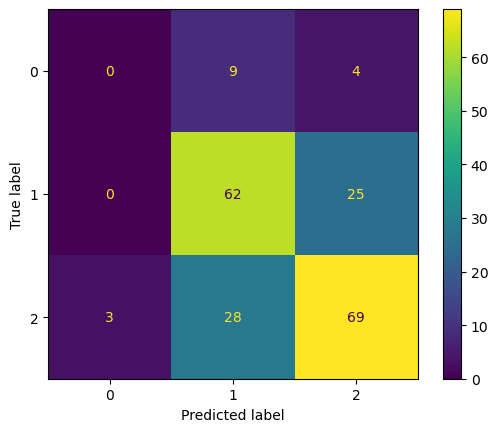

In [113]:
## evaluate DT model
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import ConfusionMatrixDisplay
#dt_predict = dt_fitting.predict(X_test)
best_dt_predict = best_dt.predict(X_test)
## Score report is compatible with multi-labels
print(f"\nScore report of a DT classification of {target_attrib} [supplement: {use_supplement}] of {target_lang} using {source_type} {term_type}{hash_status}")
print(classification_report(y_test_single, best_dt_predict, zero_division = 0.0))
## Confusion matrix: accepts only single-label output
dt_cm = confusion_matrix(y_test_single, best_dt_predict)
print(f"Confusion matrix of a DT classification of {target_attrib} [supplement: {use_supplement}] in {target_lang} using {source_type} {term_type}{hash_status}")
ConfusionMatrixDisplay(dt_cm).plot()
print(dt_cm)

In [114]:
## plot Decision Tree result
import matplotlib.pyplot as plt
#draw_trees = False
if draw_trees:
    plt.figure(figsize = (130, 60))
    ax = plt.axes()
    #figure = plt.figure()
    tree.plot_tree(best_dt, feature_names = X_train.columns, class_names = y_train_single, filled = True, fontsize = 12) # gives unusual coloring
    #tree.plot_tree (dt_fitting_single, feature_names = X_train.columns, class_names = y_train_single, filled = True, fontsize = 12)
    title = f"DT classification of {target_attrib} in {target_lang} using {explanatory_var}{hash_status}"
    plt.title(title)

# Random Forest Analysis

In [115]:
## run Random Forest
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
# use random search to find the best hyperparameters
rf = RandomForestClassifier ()
rf_searchc_params = { 'n_estimators': randint(10, 120), 'max_depth': randint(2, 40)}
rf_rand_search = RandomizedSearchCV (rf, param_distributions = rf_searchc_params, n_iter = 5, cv = 5)
# fit the random search object to the data
rf_rand_search.fit(X_train, y_train_single)
# determine variables for the best model
best_rf = rf_rand_search.best_estimator_
print('best hyper-parameters:', rf_rand_search.best_params_)
# extract best parameter values
best_max_depth = rf_rand_search.best_params_['max_depth']
best_n_estimators = rf_rand_search.best_params_['n_estimators']

best hyper-parameters: {'max_depth': 36, 'n_estimators': 103}



Score report of a RF (max_depth: 36, n_estimators: 103) classification of gender [supplement: False]  using: spell 2gram-no-hash
              precision    recall  f1-score   support

        Comm       0.00      0.00      0.00        13
         Fem       0.75      0.80      0.78        87
        Masc       0.79      0.85      0.82       100

    accuracy                           0.78       200
   macro avg       0.52      0.55      0.53       200
weighted avg       0.72      0.78      0.75       200

Confusion matrix of a RF (max_depth: 36, n_estimators: 103) of gender [supplement: False] in French using: spell 2gram-no-hash
[[ 0  8  5]
 [ 0 70 17]
 [ 0 15 85]]


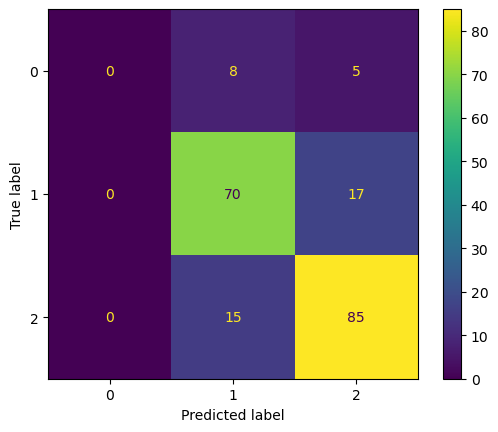

In [116]:
## evaluate RF model
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import ConfusionMatrixDisplay
rf_predict = best_rf.predict(X_test)
##
print(f"\nScore report of a RF (max_depth: {best_max_depth}, n_estimators: {best_n_estimators}) classification of {target_attrib} [supplement: {use_supplement}]  using: {source_type} {term_type}{hash_status}")
print(classification_report(y_test_single, rf_predict, zero_division = 0))
##
print(f"Confusion matrix of a RF (max_depth: {best_max_depth}, n_estimators: {best_n_estimators}) of {target_attrib} [supplement: {use_supplement}] in {target_lang} using: {source_type} {term_type}{hash_status}")
rf_cm = confusion_matrix(y_test_single, rf_predict)
ConfusionMatrixDisplay(rf_cm).plot()
print(rf_cm)

In [117]:
## plot Random Forest results
import matplotlib.pyplot as plt
if draw_trees:
    plt.figure(figsize = (130, 60))
    tree.plot_tree (best_rf.estimators_[0], feature_names = X_train.columns, class_names = y_train_single, filled = True, fontsize = 12)
    title = f"Random Forest (max_depth: {best_max_depth}, n_estimators: {best_n_estimators}) classification of {target_attrib} [supplement: {use_supplement}] in {target_lang} using {explanatory_var}{hash_status}"
    plt.subtitle = title

# Analysis: NN Analysis

In [118]:
## install keras on necessity
#!conda install keras TensorFlow -y

In [119]:
## build NN model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.optimizers import SGD, Adam
##
NN_model = Sequential()
## settings
input_size  = X_train.shape[1]
print(f"input_size: {input_size}")
output_size = y_train.shape[1]
print(f"output_size: {output_size}")

k = 1.5
base_n        = round (k * math.sqrt(input_size))
dropout_rate  = 0.1
## activation for input and hidden layers
activation_funcs         = [ 'sigmoid', 'tanh', 'relu', 'softmax' ]
activation_func          = activation_funcs[1]
print(f"activation_func: {activation_func}")

## activation for output layer
output_activation_func   = activation_funcs[1]
print(f"output_activation_func: {output_activation_func}")

## input layer
NN_model.add (Dense(base_n, activation = activation_func, input_dim = input_size))
NN_model.add (Dropout(dropout_rate))

## hidden layer
n_hidden_layers = 3
divider         = 3

layer_ids = range (1, n_hidden_layers + 1)
down_sized_layers = [2,4,6,8]
for i in layer_ids:
    if i in down_sized_layers:
        n_units = int(round (base_n / divider, 0))
        print (f"adding {n_units} units at hidden layer {i}")
    else:
        n_units = base_n
        print (f"adding {n_units} units at hidden layer {i}")
    #
    NN_model.add (Dense(input_dim = input_size, units = n_units))
    NN_model.add (Activation(activation_func))
    NN_model.add (Dropout(dropout_rate))

## output layer
forced_choice = True
if target_attrib in [ 'gender', 'plurality', 'case' ]:
    if forced_choice:
        output_activation_func = 'softmax'
    else:
        output_activation_func = activation_func
print(f"output_activation_func is reset to: {output_activation_func}")
NN_model.add (Dense(output_size, activation = output_activation_func))

##
lr_val = 0.01
use_Adam = False
adam = Adam(learning_rate = lr_val)
sgd  = SGD (learning_rate = lr_val, decay = 1e-6, momentum = 0.9, nesterov = True)
if use_Adam:
    #NN_model.compile (loss = 'binary_crossentropy', optimizer = adam, metrics = ['accuracy'])
    NN_model.compile (loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
else:
    #NN_model.compile (loss = 'binary_crossentropy', optimizer = sgd, metrics = ['accuracy'])
    NN_model.compile (loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['accuracy'])

input_size: 314
output_size: 3
activation_func: tanh
output_activation_func: tanh
adding 27 units at hidden layer 1
adding 9 units at hidden layer 2
adding 27 units at hidden layer 3


/Users/kowk/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


output_activation_func is reset to: softmax


/Users/kowk/opt/anaconda3/lib/python3.11/site-packages/keras/src/optimizers/base_optimizer.py:33: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


In [120]:
## train NN model: requires Python 3.11 or later to complete
NN_model.fit (X_train, y_train, epochs = 150, verbose = 0)

In [121]:
## generate NN_predict
print(f"output_activation_func: {output_activation_func}")
NN_predict = NN_model.predict (X_test)
#random.sample(list(NN_predict), 10)

## value conversion on NN predict
if output_activation_func == 'softmax':
    threshold = 1/len(target.columns)
    NN_predict [ NN_predict >= threshold ] = int(1)
    NN_predict [ NN_predict < threshold ]  = int(0)
else:
    if  output_activation_func == 'sigmoid':
        threshold = 0.5
        NN_predict [ NN_predict >= threshold ] = int(1)
        NN_predict [ NN_predict < threshold ]  = int(0)
    elif output_activation_func == 'tanh':
        threshold = 0
        NN_predict [ NN_predict >= threshold ] = int(1)
        NN_predict [ NN_predict < threshold ]  = int(0)
print(f"threshold set to: {threshold}")
#random.sample(list(NN_predict), 10)

output_activation_func: softmax
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
threshold set to: 0.3333333333333333


output_activation_func: softmax

Score report of a mMM classification of gender [supplement: False] in French using: spell 2gram-no-hash
              precision    recall  f1-score   support

           0       0.72      0.80      0.76        87
           1       0.80      0.77      0.79       100
           2       0.29      0.15      0.20        13

    accuracy                           0.74       200
   macro avg       0.60      0.58      0.58       200
weighted avg       0.73      0.74      0.74       200

Confusion matrix of a NN classification of gender [supplement: False] in French using spell 2gram-no-hash
[[70 15  2]
 [20 77  3]
 [ 7  4  2]]


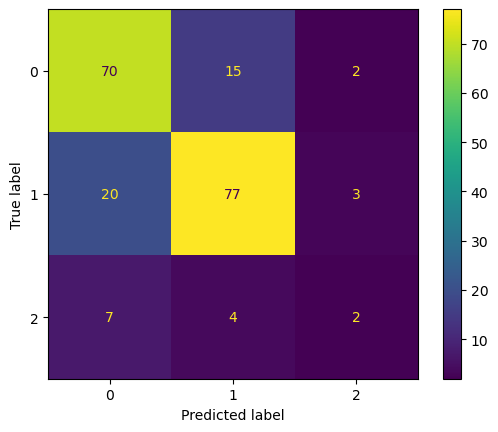

In [122]:
## evaluate NN
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import ConfusionMatrixDisplay
print(f"output_activation_func: {output_activation_func}")
if output_activation_func == 'softmax':
    ## convert distribution to determnisitc values using argmax
    NN_predict_converted = [ x.argmax() for x in NN_predict ]
    y_test_converted = [ x.argmax() for i, x in y_test.iterrows() ]
    ##
    print(f"\nScore report of a mMM classification of {target_attrib} [supplement: {use_supplement}] in {target_lang} using: {source_type} {term_type}{hash_status}")
    print(classification_report(y_test_converted, NN_predict_converted, zero_division = 0.0))
    ##
    print(f"Confusion matrix of a NN classification of {target_attrib} [supplement: {use_supplement}] in {target_lang} using {source_type} {term_type}{hash_status}")
    NN_cm = confusion_matrix (y_test_converted, NN_predict_converted)
    print(NN_cm)
    ConfusionMatrixDisplay(NN_cm).plot()
else:
    for i in range(len(target_cols)):
        test, predict = y_test.iloc[:,i], list(map(int, NN_predict[:,i]))
        ##
        print(f"\nScore report of a NN classification of {target_attrib} [supplement: {use_supplement}] in {target_lang} for {target_cols[i]} using {source_type} {term_type}{hash_status}")
        print(classification_report(test, predict, zero_division = 0.0))
        ##
        print(f"Confusion matrix of a NN classification of {target_attrib} [supplement: {use_supplement}] in {target_lang} for {target_cols[i]} using {source_type} {term_type}{hash_status}")
        NN_cm = confusion_matrix (test, predict)
        print(NN_cm)
        ConfusionMatrixDisplay(NN_cm).plot()